In [1]:
import pandas as pd
import numpy as np
import DyLoPro as dlp

# Preprocessing/Testing

In [2]:
from preprocess_case_studies import preprocess_RTFM
path_to_RTFM = 'datasets/road_traffic.csv'
log = pd.read_csv(path_to_RTFM, header = 0)
log = preprocess_RTFM(log)
log

,amount,org:resource,dismissal,concept:name,vehicleClass,totalPaymentAmount,time:timestamp,article,points,case:concept:name,...,notificationType,lastSent,paymentAmount,outcome_dismissed,last_amount,last_totalPaymentAmount,outcome_payment,outcome_fully_paid,outcome_partially_paid,outcome_unpaid
0,35.0,561,NIL,Create Fine,A,0.0,2006-07-24 00:00:00+00:00,157,0,A1,...,None,None,NaN,0,35.0,0.0,unpaid,0,0,1
1,NaN,561,NaN,Send Fine,A,NaN,2006-12-05 00:00:00+00:00,157,0,A1,...,None,None,NaN,0,35.0,0.0,unpaid,0,0,1
2,35.0,561,NIL,Create Fine,A,0.0,2006-08-02 00:00:00+00:00,157,0,A100,...,P,P,NaN,0,71.5,0.0,unpaid,0,0,1
3,NaN,561,NaN,Send Fine,A,NaN,2006-12-12 00:00:00+00:00,157,0,A100,...,P,P,NaN,0,71.5,0.0,unpaid,0,0,1
4,NaN,561,NaN,Insert Fine Notification,A,NaN,2007-01-15 00:00:00+00:00,157,0,A100,...,P,P,NaN,0,71.5,0.0,unpaid,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
561465,131.0,25,NIL,Create Fine,A,0.0,2002-09-07 00:00:00+00:00,142,0,V9999,...,P,N,NaN,0,262.0,0.0,unpaid,0,0,1
561466,NaN,25,NaN,Send Fine,A,NaN,2002-10-25 00:00:00+00:00,142,0,V9999,...,P,N,NaN,0,262.0,0.0,unpaid,0,0,1
561467,NaN,25,NaN,Insert Fine Notification,A,NaN,2002-11-04 00:00:00+00:00,142,0,V9999,...,P,N,NaN,0,262.0,0.0,unpaid,0,0,1
561468,262.0,25,NaN,Add penalty,A,NaN,2003-01-03 00:00:00+00:00,142,0,V9999,...,P,N,NaN,0,262.0,0.0,unpaid,0,0,1


In [4]:
# Show all columns with types and non-null counts
log.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 561470 entries, 0 to 561469
Data columns (total 15 columns):
 #   Column              Non-Null Count   Dtype              
---  ------              --------------   -----              
 0   amount              230230 non-null  float64            
 1   org:resource        561470 non-null  object             
 2   dismissal           155066 non-null  object             
 3   concept:name        561470 non-null  object             
 4   vehicleClass        561470 non-null  object             
 5   totalPaymentAmount  227971 non-null  float64            
 6   time:timestamp      561470 non-null  datetime64[ns, UTC]
 7   article             561470 non-null  object             
 8   points              561470 non-null  object             
 9   case:concept:name   561470 non-null  object             
 10  expense             561470 non-null  float64            
 11  notificationType    561470 non-null  object             
 12  lastSent        

In [27]:
# Check if the amount stays the same during the case
log.groupby('case:concept:name')['vehicleClass'].nunique().value_counts()

vehicleClass
1    150370
Name: count, dtype: int64

In [15]:
# check type of org:resource
log['points'].dtype

dtype('O')

In [16]:
#Show all unique values expense column
log['points'].unique()

array([0.0, 2.0, 5.0, 10.0, 6.0, 3.0, 4.0, 1.0, 8.0], dtype=object)

In [81]:
log[log['concept:name'] == 'Appeal to Judge']

,amount,org:resource,dismissal,concept:name,vehicleClass,totalPaymentAmount,time:timestamp,article,points,case:concept:name,expense,notificationType,lastSent,paymentAmount,outcome_dismissed
5342,NaN,0.0,G,Appeal to Judge,A,NaN,2008-01-21 00:00:00+00:00,157.0,0.0,A12414,22.00,P,P,NaN,1
10049,NaN,0.0,NIL,Appeal to Judge,A,NaN,2007-10-09 00:00:00+00:00,157.0,0.0,A14727,13.00,P,P,NaN,0
10916,NaN,0.0,NIL,Appeal to Judge,A,NaN,2007-01-05 00:00:00+00:00,157.0,0.0,A1516,11.00,P,P,NaN,0
11325,NaN,0.0,NIL,Appeal to Judge,A,NaN,2008-02-05 00:00:00+00:00,7.0,0.0,A15307,13.00,P,P,NaN,0
12393,NaN,0.0,G,Appeal to Judge,A,NaN,2007-04-24 00:00:00+00:00,157.0,0.0,A1582,22.00,P,P,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560220,NaN,0.0,NIL,Appeal to Judge,A,NaN,2002-11-05 00:00:00+00:00,142.0,0.0,V9518,10.00,P,N,NaN,0
560330,NaN,0.0,NIL,Appeal to Judge,A,NaN,2003-05-22 00:00:00+00:00,142.0,0.0,V9560,13.00,P,N,NaN,0
560360,NaN,0.0,NIL,Appeal to Judge,A,NaN,2003-05-02 00:00:00+00:00,142.0,0.0,V9576,15.16,P,N,NaN,0
560764,NaN,0.0,NIL,Appeal to Judge,A,NaN,2002-11-01 00:00:00+00:00,142.0,0.0,V9715,10.00,P,N,NaN,0


In [3]:
log[log['case:concept:name']== 'A12414']

,amount,org:resource,dismissal,concept:name,vehicleClass,totalPaymentAmount,time:timestamp,article,points,case:concept:name,expense,notificationType,lastSent,paymentAmount,outcome_dismissed
5334,36.0,541,NIL,Create Fine,A,0.0,2007-05-12 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5335,NaN,541,NaN,Send Fine,A,NaN,2007-08-20 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5336,NaN,541,NaN,Insert Fine Notification,A,NaN,2007-09-03 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5337,NaN,541,NaN,Insert Date Appeal to Prefecture,A,NaN,2007-10-22 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5338,74.0,541,NaN,Add penalty,A,NaN,2007-11-02 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5339,NaN,541,NIL,Send Appeal to Prefecture,A,NaN,2007-12-07 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5340,NaN,541,NaN,Receive Result Appeal from Prefecture,A,NaN,2007-12-18 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5341,NaN,541,NaN,Notify Result Appeal to Offender,A,NaN,2007-12-21 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1
5342,NaN,0,G,Appeal to Judge,A,NaN,2008-01-21 00:00:00+00:00,157,0,A12414,22.0,P,P,NaN,1


In [31]:
log[log['case:concept:name']== 'V3904']

,amount,org:resource,dismissal,concept:name,vehicleClass,totalPaymentAmount,time:timestamp,article,points,case:concept:name,expense,notificationType,lastSent,paymentAmount,outcome_dismissed
546162,31.30,29,NIL,Create Fine,A,0.0,2000-01-05 00:00:00+00:00,142,0,V3904,6.46,P,N,NaN,0
546163,NaN,29,NaN,Send Fine,A,NaN,2000-03-23 00:00:00+00:00,142,0,V3904,6.46,P,N,NaN,0
546164,NaN,29,NaN,Insert Fine Notification,A,NaN,2000-04-17 00:00:00+00:00,142,0,V3904,6.46,P,N,NaN,0
546165,NaN,29,NaN,Insert Date Appeal to Prefecture,A,NaN,2000-04-21 00:00:00+00:00,142,0,V3904,6.46,P,N,NaN,0
546166,62.59,29,NaN,Add penalty,A,NaN,2000-06-16 00:00:00+00:00,142,0,V3904,6.46,P,N,NaN,0
546167,NaN,29,NIL,Send Appeal to Prefecture,A,NaN,2011-12-25 00:00:00+00:00,142,0,V3904,6.46,P,N,NaN,0


In [29]:
case_duration = (
    log.groupby('case:concept:name')['time:timestamp']
       .agg(['min', 'max'])
)

case_duration['duration_days'] = (case_duration['max'] - case_duration['min']).dt.days
case_duration['duration_days'].describe()


count    150370.000000
mean        341.670845
std         347.051441
min           0.000000
25%          12.000000
50%         198.000000
75%         605.000000
max        4372.000000
Name: duration_days, dtype: float64

In [30]:
# show the case that lasted the longest
# Find the case(s) with the longest duration
longest_case = case_duration['duration_days'].idxmax()
longest_duration = case_duration['duration_days'].max()

print("Case with longest duration:", longest_case)
print("Duration in days:", longest_duration)

Case with longest duration: V3904
Duration in days: 4372


In [34]:
# Get top 5 longest cases
top_5_longest = case_duration.sort_values(by='duration_days', ascending=False).head(20)

print(top_5_longest)


                                        min                       max  \
case:concept:name                                                       
V3904             2000-01-05 00:00:00+00:00 2011-12-25 00:00:00+00:00   
N22795            2000-01-25 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V4290             2000-02-05 00:00:00+00:00 2011-12-25 00:00:00+00:00   
S38092            2000-02-07 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V4358             2000-02-26 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V4425             2000-03-09 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V5141             2000-06-08 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V5285             2000-06-13 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V5624             2000-06-23 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V6005             2000-07-19 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V6555             2000-08-24 00:00:00+00:00 2011-12-25 00:00:00+00:00   
V6689             2000-09-12 00:00:00+00:00 2011-12

In [9]:
log['notificationType'].value_counts()

notificationType
P       415722
None    145026
C          722
Name: count, dtype: int64

# DyLoPro feature specification

In [4]:
categorical_casefeatures = ['vehicleClass', 'article', 'points', 'notificationType', 'lastSent']
categorical_eventfeatures = ['org:resource', 'dismissal']
numeric_eventfeatures = ['amount', 'totalPaymentAmount', 'paymentAmount']
numeric_casefeatures = ['expense']

In [5]:
rtfm_plots = dlp.DynamicLogPlots(log, 
                                 case_id_key = 'case:concept:name', 
                                 activity_key = 'concept:name', 
                                 timestamp_key = 'time:timestamp', 
                                 categorical_casefeatures = categorical_casefeatures, 
                                 numerical_casefeatures= numeric_casefeatures,
                                 categorical_eventfeatures = categorical_eventfeatures, 
                                 numerical_eventfeatures = numeric_eventfeatures,
                                 outcome='outcome_dismissed', end_date='31/12/2012')

Preprocessing the data...


C:\Users\20193673\AppData\Roaming\Python\Python311\site-packages\DyLoPro\preprocess_utils.py:274: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  log['hourly_timestamp'] = timestamps.dt.floor("1H")
C:\Users\20193673\AppData\Roaming\Python\Python311\site-packages\DyLoPro\preprocess_utils.py:277: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  log['2hour_timestamp'] = timestamps.dt.floor("2H")
C:\Users\20193673\AppData\Roaming\Python\Python311\site-packages\DyLoPro\preprocess_utils.py:280: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  log['12hour_timestamp'] = timestamps.dt.floor("12H")
100%|██████████| 530648/530648 [00:00<00:00, 1767721.32it/s]


# Variants

RTFM contains 231 variants for ~150,000 cases. The three most occuring variants cover about 82% of the total amount of cases. 

In [30]:
var_df = rtfm_plots.get_var_df(max_k = 10, counts = True)
print(var_df.to_string())

                                                                                                                                     variant  variant count
variant number                                                                                                                                             
1                                                (Create Fine, Send Fine, Insert Fine Notification, Add penalty, Send for Credit Collection)          51864
2                                                                                                                     (Create Fine, Payment)          45851
3                                                                                                                   (Create Fine, Send Fine)          19279
4                                                                   (Create Fine, Send Fine, Insert Fine Notification, Add penalty, Payment)           9319
5                                                          (Crea

#### Representation type: Throughput Time

We only want consider completed cases, however it is hard to determine when a case has finished, since there are multiple events that can indicate an event may be completed. To somewhat combat this problem, we only include cases that had their last event recorded before 2013. Since most cases are completed within 6 months, we assume that the cases that recorded an event before 1-1-2013, but no event after that until 2013-06-18(end date of the event log) are finished.

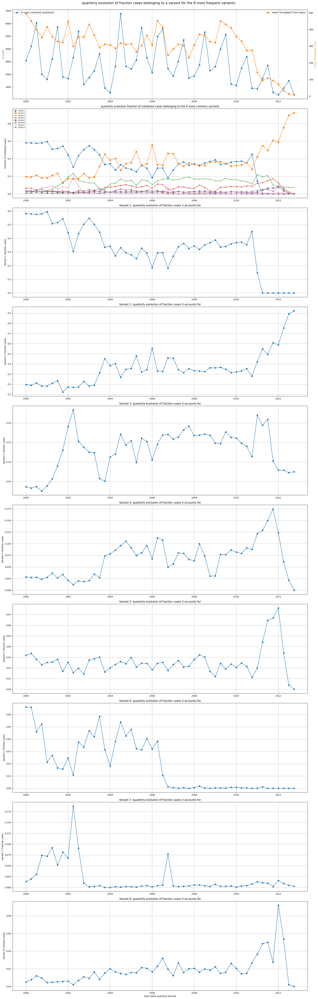

In [26]:
rtfm_plots.topK_variants_evol(plt_type = 'univariate', max_k=8, frequency='quarterly', xtr_outlier_rem=False)

Computing additional quarterly Throughput Time aggregations for each of the 8 most frequently occurring variants: 100%|██████████| 8/8 [00:00<00:00, 21.97it/s]


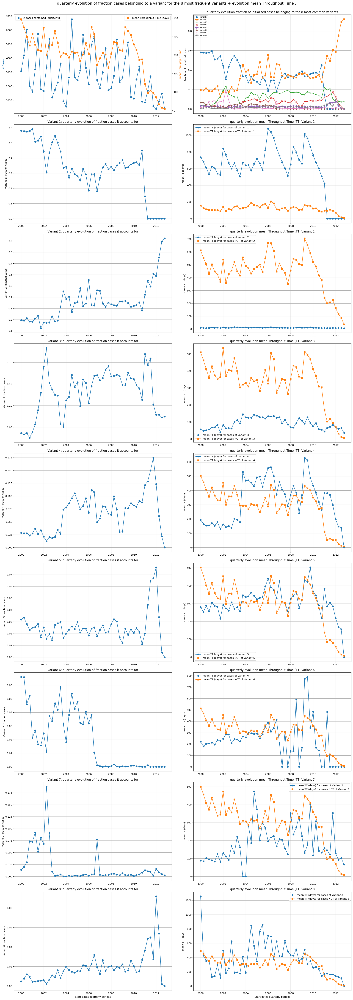

In [36]:
rtfm_plots.topK_variants_evol(plt_type = 'type_tt', max_k=8, frequency='quarterly', xtr_outlier_rem=False)

#### Representation type: Outcome

Computing additional quarterly outcome aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 11.56it/s]


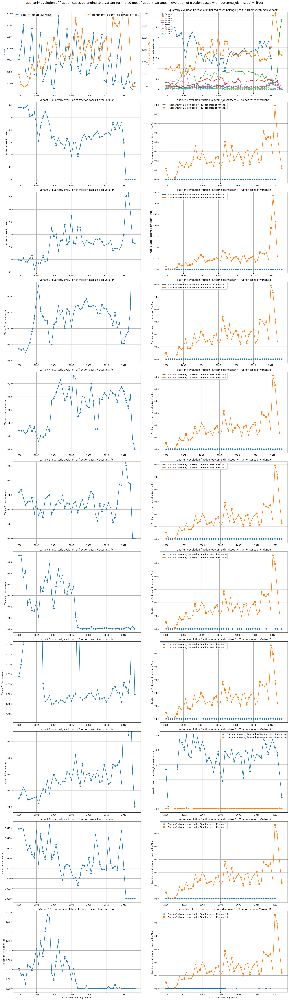

In [35]:
rtfm_plots.topK_variants_evol(plt_type = 'type_outcome', frequency='quarterly', max_k = 10)

# Categorical Case Features

In [66]:
categorical_casefeatures

['vehicleClass', 'article', 'points', 'notificationType', 'lastSent']

#### CCF: vehicleClass

##### Representation type: Throughput Time

Computing additional quarterly aggregations of the Throughput Time for each of the 4 most frequently occurring levels: 100%|██████████| 4/4 [00:00<00:00, 13.38it/s]


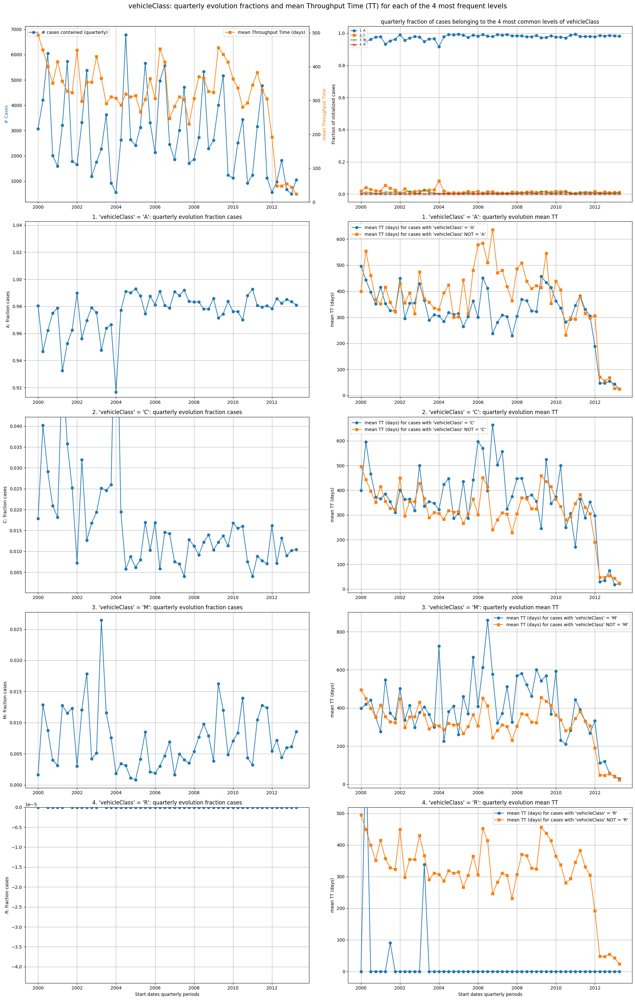

In [51]:
# Mean TT cases per vehicle class over time
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'vehicleClass', plt_type = 'type_tt', frequency='quarterly')

##### Representation type: Case length

Computing additional quarterly aggregations of the Number of Events Per Case (NEPC) for each of the 4 most frequently occurring levels: 100%|██████████| 4/4 [00:00<00:00, 12.69it/s]


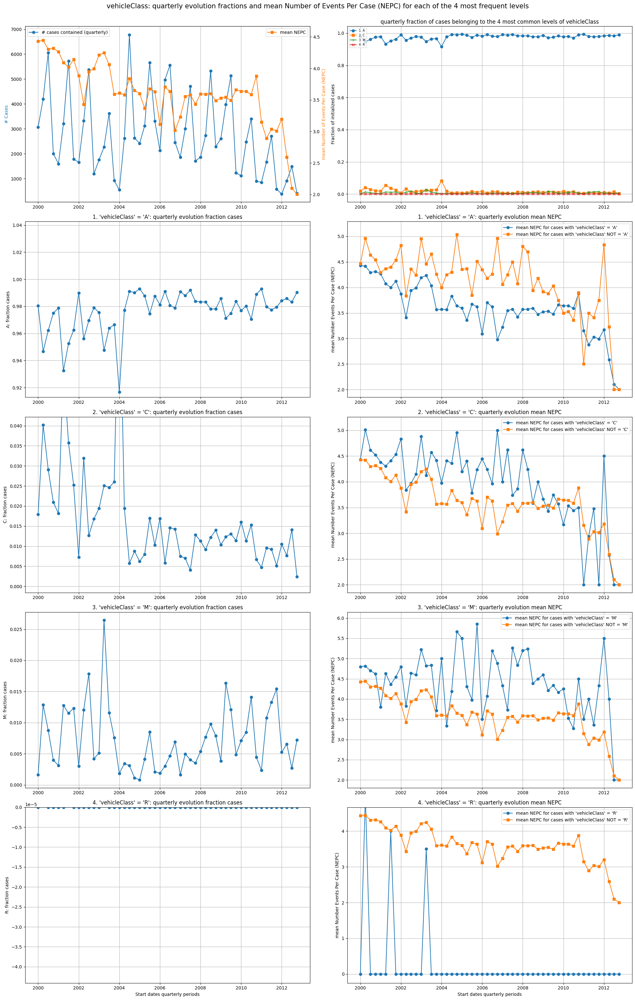

In [41]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'vehicleClass', plt_type = 'type_events_case', frequency='quarterly')

##### Representation type: Outcome

Computing additional quarterly outcome aggregations for each of the 4 most frequently occurring levels: 100%|██████████| 4/4 [00:00<00:00,  5.81it/s]


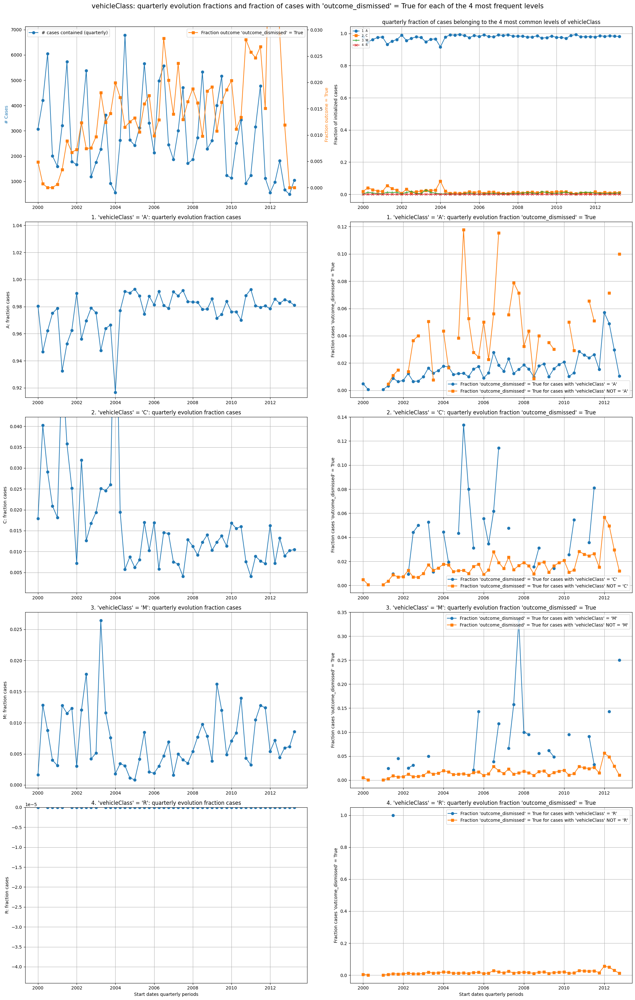

In [52]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'vehicleClass', plt_type = 'type_outcome', frequency='quarterly')

#### CCF: article

##### Representation type: Throughput Time

Computing additional quarterly aggregations of the Throughput Time for each of the 8 most frequently occurring levels: 100%|██████████| 8/8 [00:00<00:00,  9.24it/s]


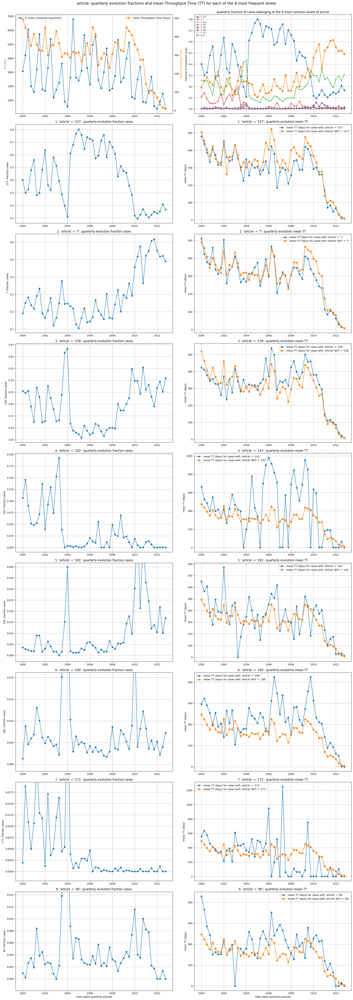

In [27]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'article', plt_type = 'type_tt', frequency='quarterly', max_k=8)

##### Representation type: Case length

Computing additional quarterly aggregations of the Number of Events Per Case (NEPC) for each of the 8 most frequently occurring levels: 100%|██████████| 8/8 [00:00<00:00, 11.20it/s]


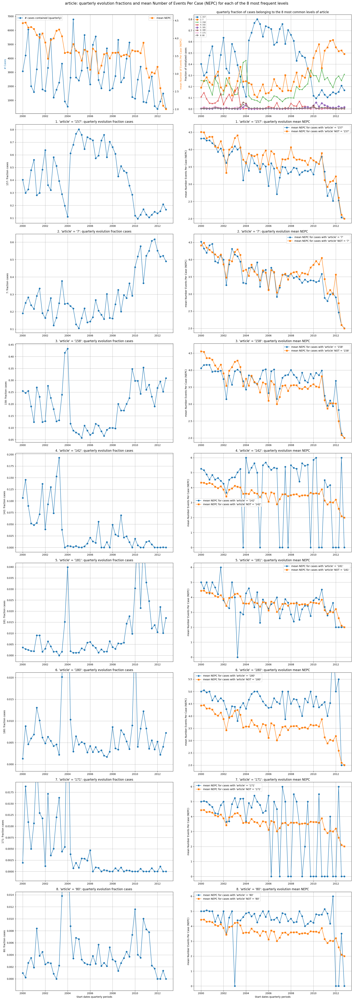

In [28]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'article', plt_type = 'type_events_case', frequency='quarterly', max_k=8)

##### Representation type: Outcome

Computing additional quarterly outcome aggregations for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:01<00:00,  5.95it/s]


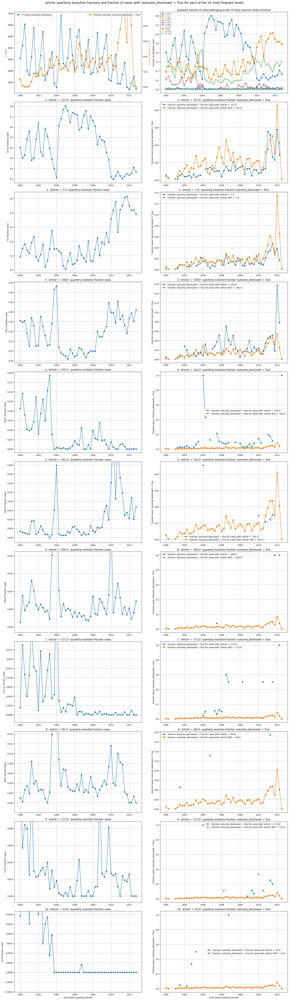

In [45]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'article', plt_type = 'type_outcome', frequency='quarterly')

#### CCF: points

##### Representation type: Throughput Time

Computing additional quarterly aggregations of the Throughput Time for each of the 9 most frequently occurring levels: 100%|██████████| 9/9 [00:00<00:00, 10.47it/s]


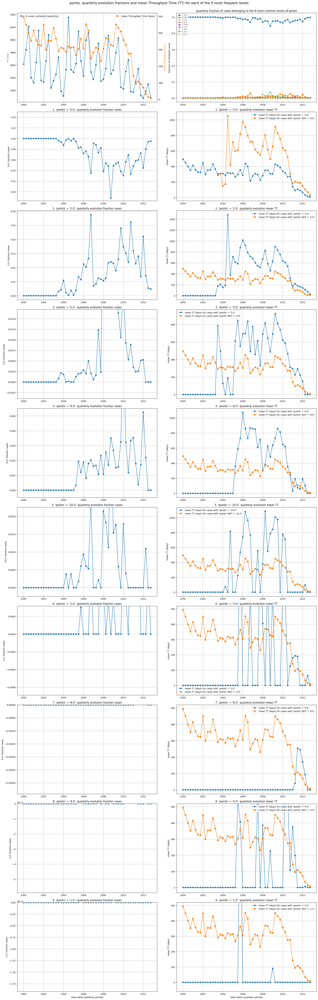

In [46]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'points', plt_type = 'type_tt', frequency='quarterly')

##### Representation type: Case Length

Computing additional quarterly aggregations of the Number of Events Per Case (NEPC) for each of the 9 most frequently occurring levels: 100%|██████████| 9/9 [00:00<00:00,  9.09it/s]


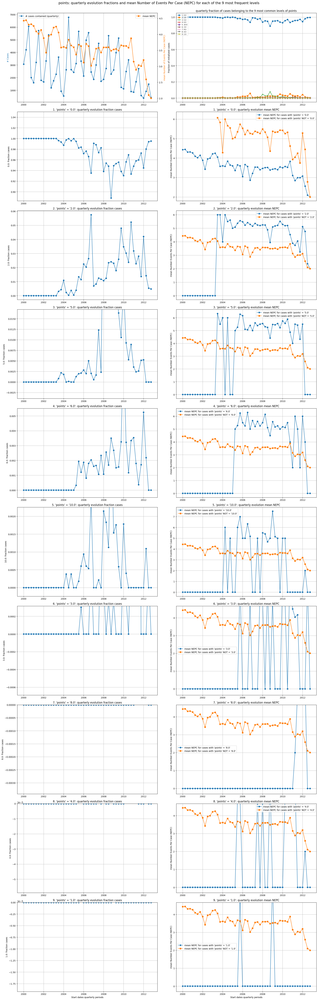

In [47]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'points', plt_type = 'type_events_case', frequency='quarterly')

##### Representation type: Outcome

Computing additional quarterly outcome aggregations for each of the 9 most frequently occurring levels: 100%|██████████| 9/9 [00:01<00:00,  7.36it/s]


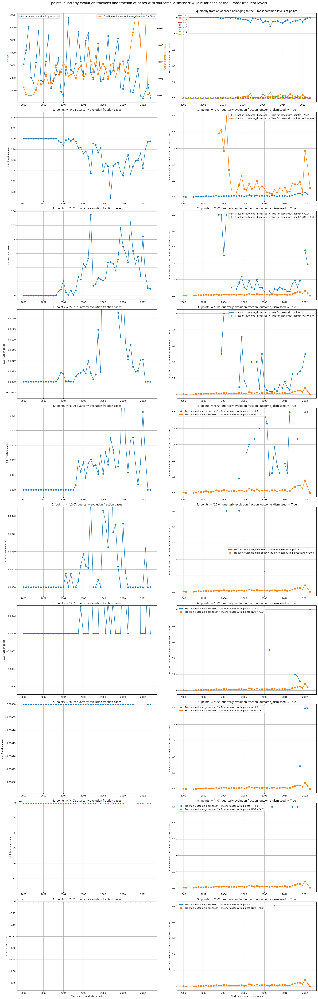

In [48]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'points', plt_type = 'type_outcome', frequency='quarterly')

#### CCF: notificationType

##### Representation type: Throughput Time

Computing additional quarterly aggregations of the Throughput Time for each of the 3 most frequently occurring levels: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s]


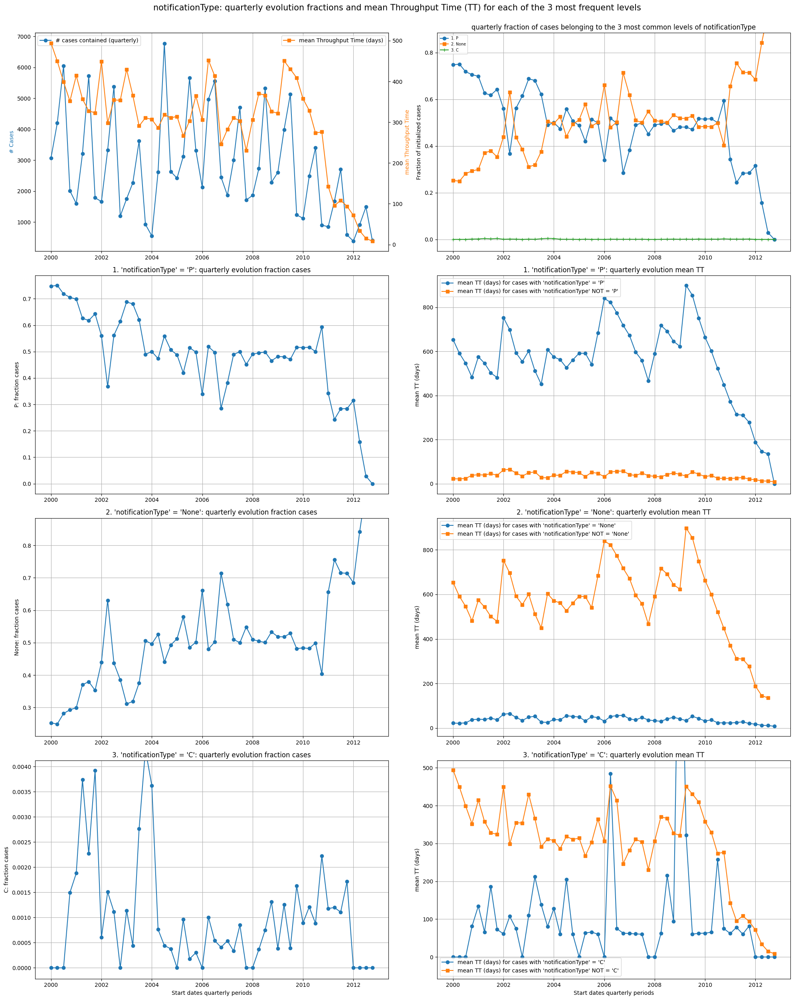

In [49]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'notificationType', plt_type = 'type_tt', frequency='quarterly')

##### Representation type: Case Length

Computing additional quarterly aggregations of the Number of Events Per Case (NEPC) for each of the 3 most frequently occurring levels: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s]


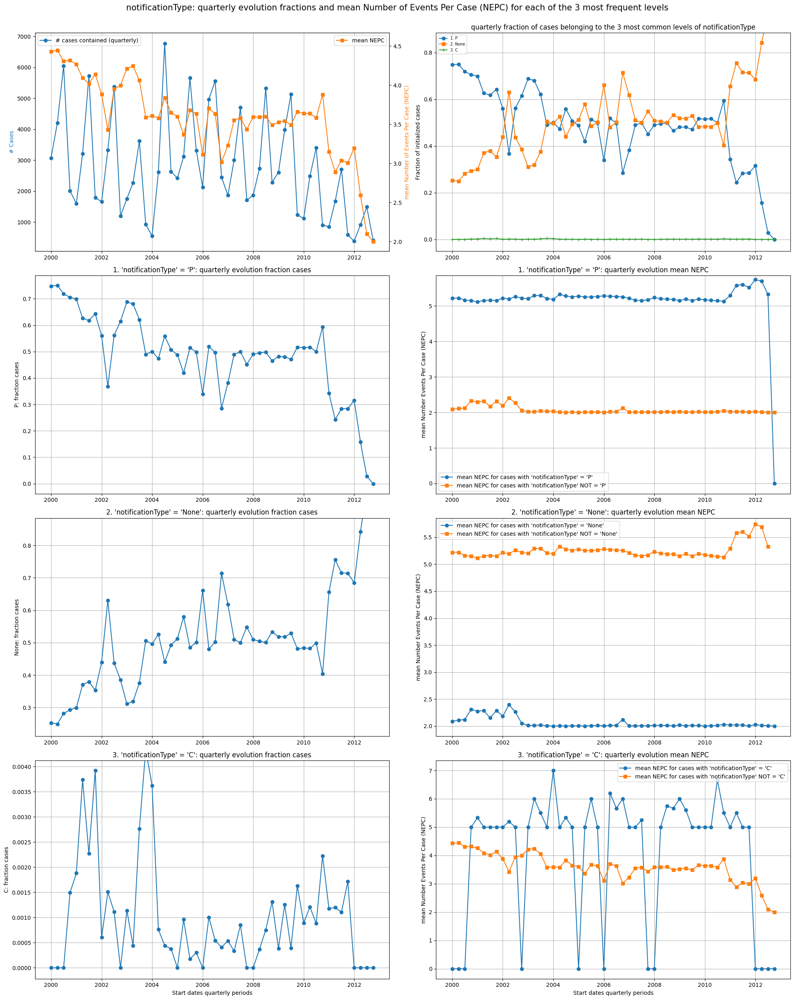

In [50]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'notificationType', plt_type = 'type_events_case', frequency='quarterly')

##### Representation type: Outcome

Computing additional quarterly outcome aggregations for each of the 3 most frequently occurring levels: 100%|██████████| 3/3 [00:00<00:00,  5.26it/s]


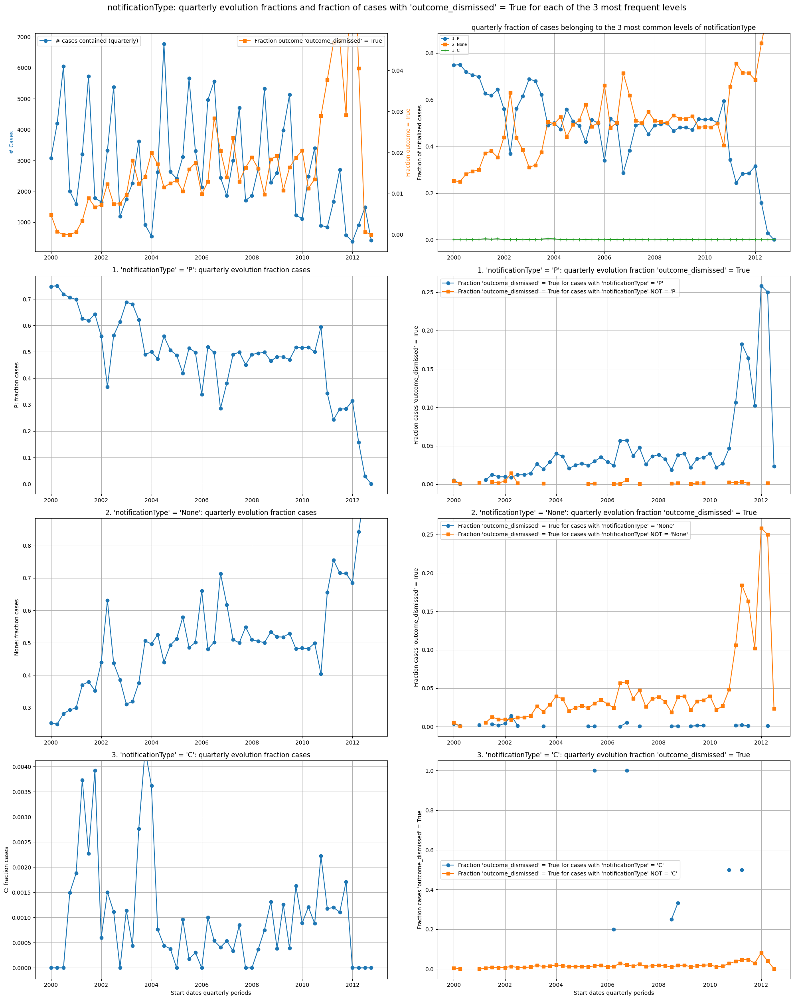

In [51]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'notificationType', plt_type = 'type_outcome', frequency='quarterly')

#### CCF: lastSent

##### Representation type: Throughput Time

Computing additional monthly aggregations of the Throughput Time for each of the 4 most frequently occurring levels: 100%|██████████| 4/4 [00:00<00:00, 12.09it/s]


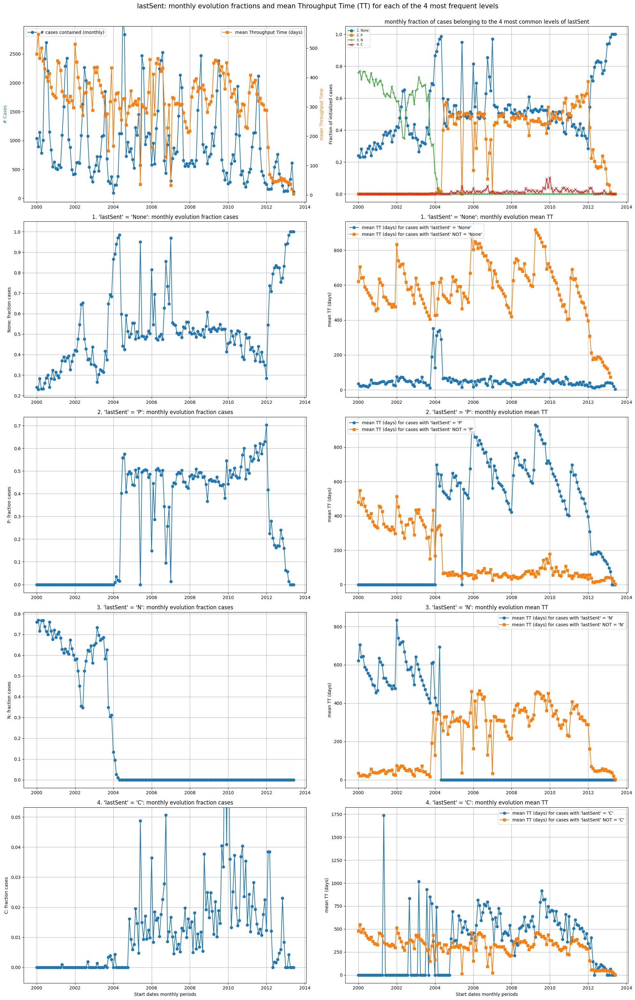

In [30]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'lastSent', plt_type = 'type_tt', frequency='monthly')

##### Representation type: Case Length

Computing additional quarterly aggregations of the Number of Events Per Case (NEPC) for each of the 4 most frequently occurring levels: 100%|██████████| 4/4 [00:00<00:00, 12.29it/s]


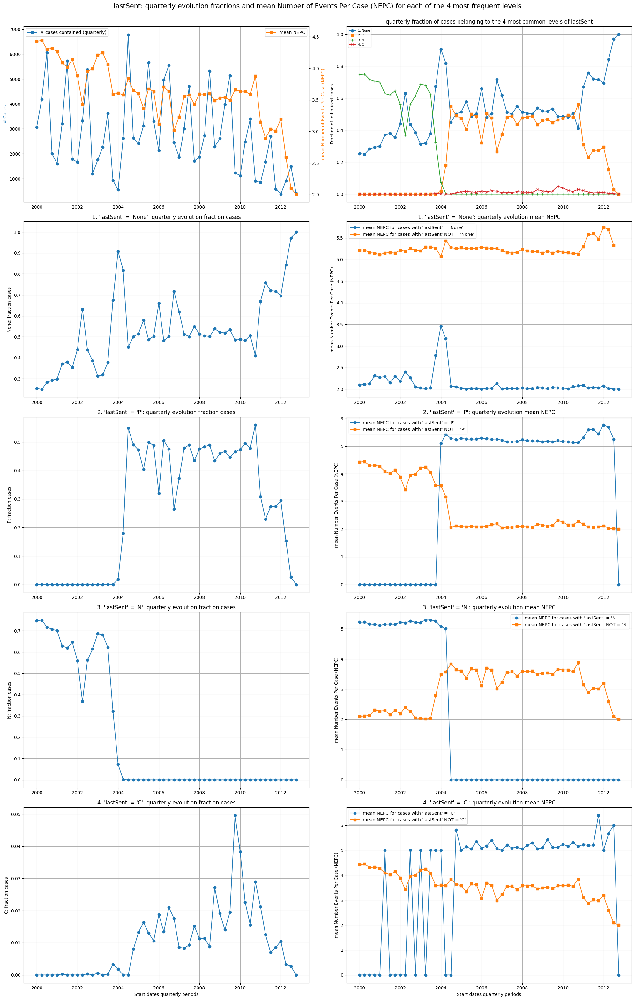

In [52]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'lastSent', plt_type = 'type_events_case', frequency='quarterly')

##### Representation type: Outcome

Computing additional quarterly outcome aggregations for each of the 4 most frequently occurring levels: 100%|██████████| 4/4 [00:00<00:00,  6.15it/s]


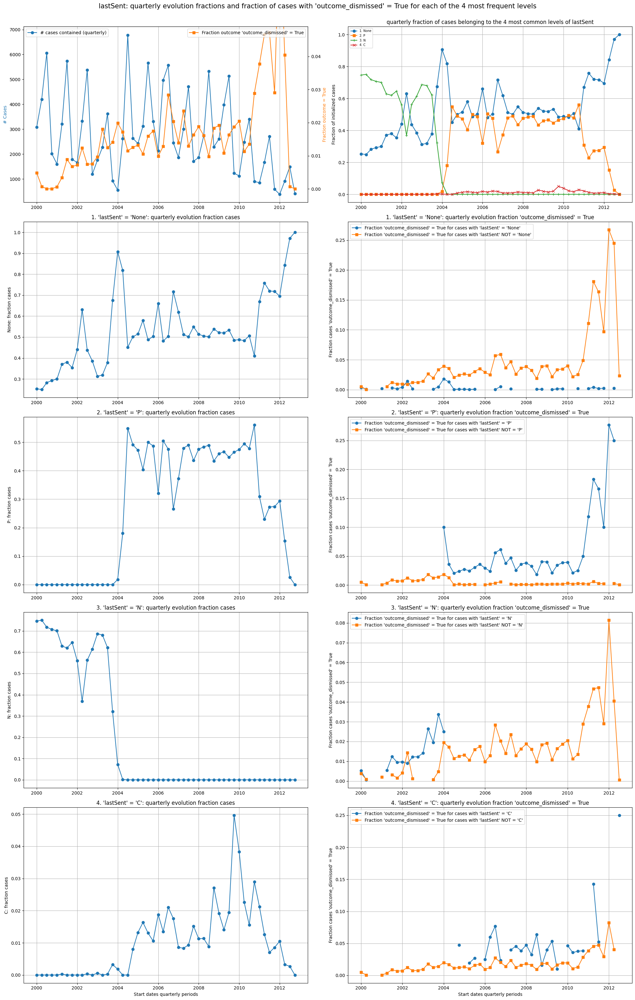

In [53]:
rtfm_plots.topK_categorical_caseftr_evol(case_feature = 'lastSent', plt_type = 'type_outcome', frequency='quarterly')

# Numeric Case Features

In [67]:
numeric_casefeatures

['expense']

#### NCF: Expense

##### Representation type: Throughput Time

C:\Users\20193673\AppData\Roaming\Python\Python311\site-packages\DyLoPro\plotting_utils.py:452: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  period_ttr = case_log_loc.pivot_table(values = num_fts_list, index = time_col, aggfunc = numeric_agg, fill_value = 0)


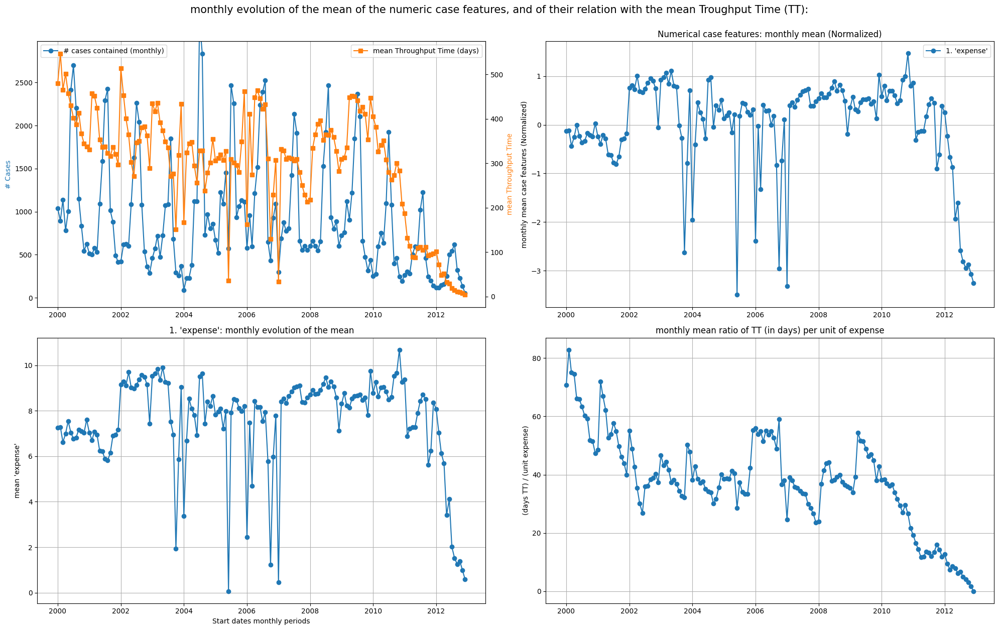

In [61]:
rtfm_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_tt', frequency = 'monthly', xtr_outlier_rem = True)

##### Representation type: Case Length

Computing the additional monthly NEPC aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00,  7.36it/s]


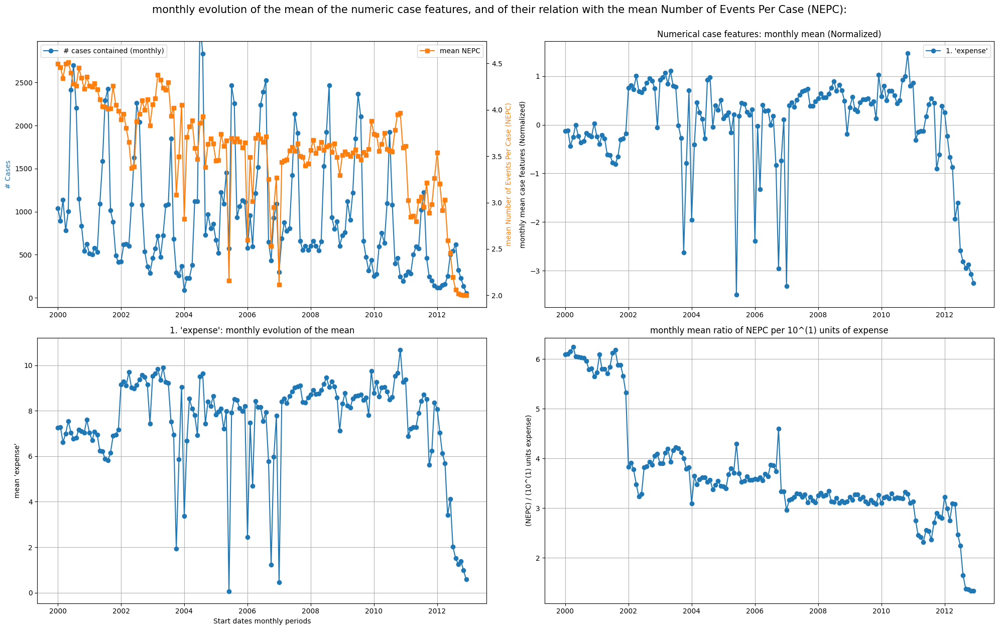

In [62]:
rtfm_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_events_case', frequency = 'monthly')

##### Representation type: Outcome

Computing the additional monthly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


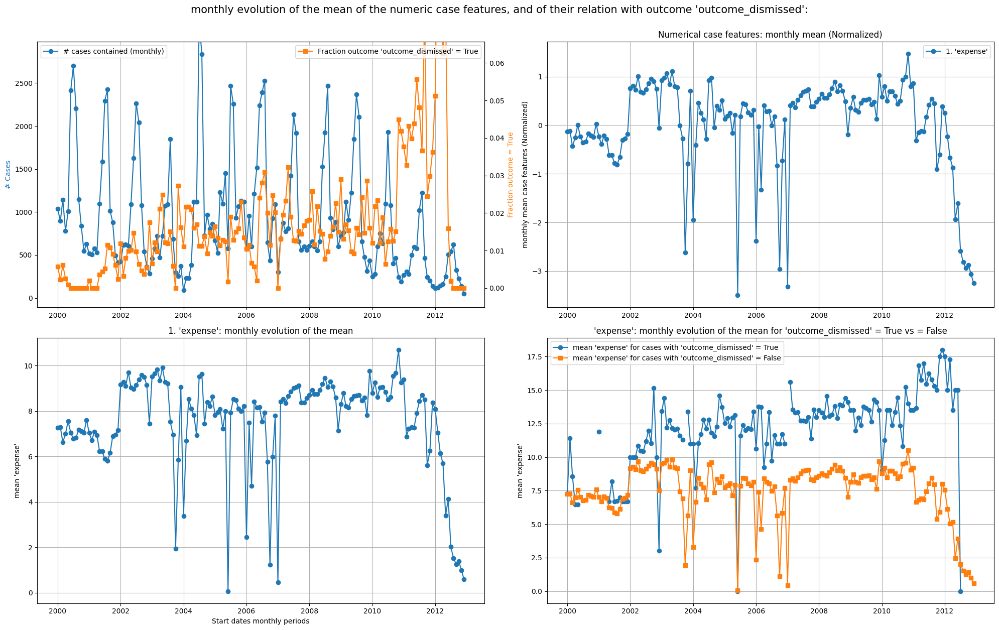

In [63]:
rtfm_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome', frequency = 'monthly')

# Categorical Event Features

In [65]:
categorical_eventfeatures

['org:resource', 'dismissal']

#### CEF: org:resource

##### Representation type: Throughput Time

Computing the quarterly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:01<00:00,  8.74it/s]


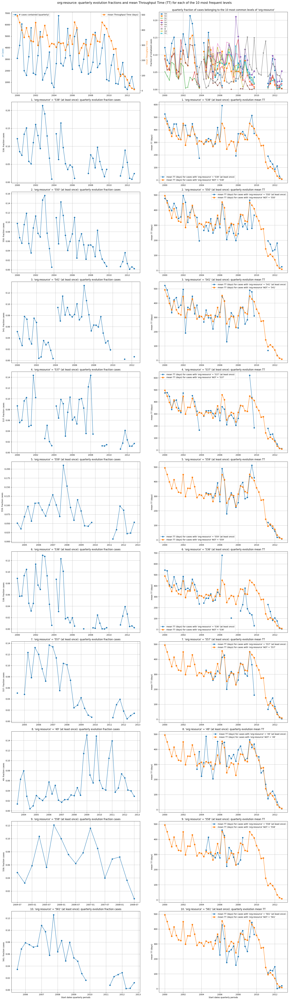

In [10]:
rtfm_plots.topK_categorical_eventftr_evol(event_feature='org:resource', plt_type = 'type_tt', frequency='quarterly', xtr_outlier_rem = False)

##### Representation type: Case Length

Computing the quarterly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 10.86it/s]


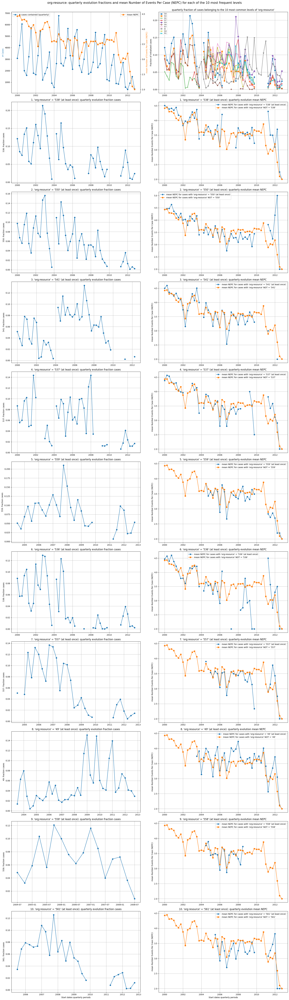

In [9]:
rtfm_plots.topK_categorical_eventftr_evol(event_feature='org:resource', plt_type = 'type_events_case', frequency='quarterly', xtr_outlier_rem = False)

##### Representation type: Outcome

Computing the monthly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:01<00:00,  5.78it/s]


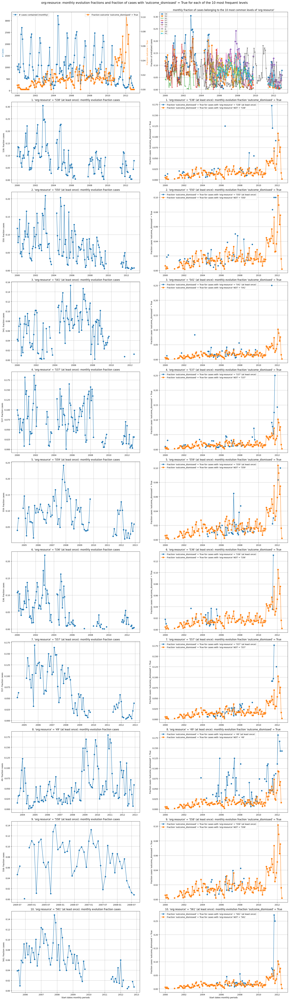

In [8]:
rtfm_plots.topK_categorical_eventftr_evol(event_feature='org:resource', plt_type = 'type_outcome', frequency='monthly', xtr_outlier_rem = False)

#### CEF: dismissal

##### Representation type: Throughput Time

Computing the quarterly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'dismissal': 100%|██████████| 10/10 [00:00<00:00, 10.02it/s]


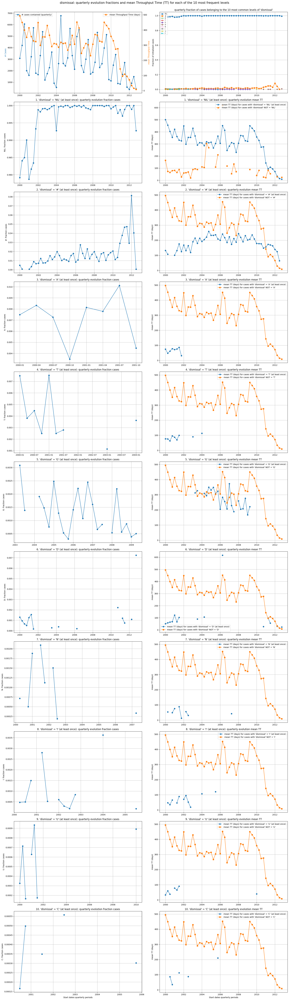

In [11]:
rtfm_plots.topK_categorical_eventftr_evol(event_feature='dismissal', plt_type = 'type_tt', frequency='quarterly', xtr_outlier_rem = False)

##### Representation type: Case Length

Computing the quarterly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'dismissal': 100%|██████████| 10/10 [00:01<00:00,  9.48it/s]


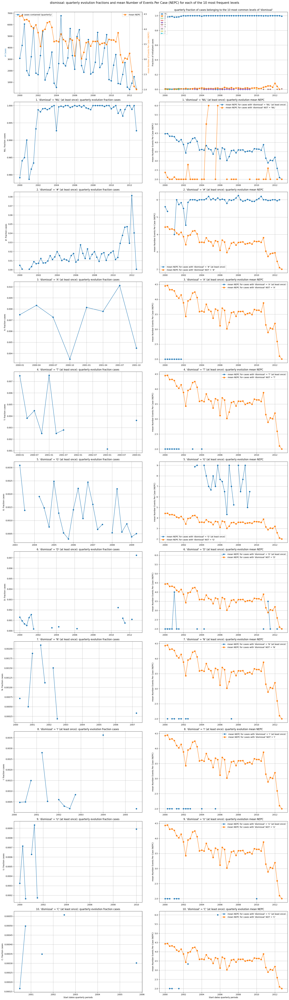

In [12]:
rtfm_plots.topK_categorical_eventftr_evol(event_feature='dismissal', plt_type = 'type_events_case', frequency='quarterly', xtr_outlier_rem = False)

##### Representation type: Outcome

Computing the monthly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'dismissal': 100%|██████████| 10/10 [00:01<00:00,  7.86it/s]


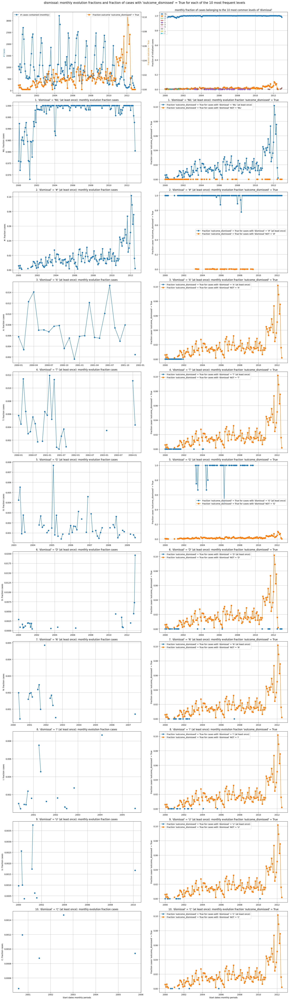

In [14]:
rtfm_plots.topK_categorical_eventftr_evol(event_feature='dismissal', plt_type = 'type_outcome', frequency='monthly', xtr_outlier_rem = False)

# Numeric Event Features

In [68]:
numeric_eventfeatures

['amount', 'totalPaymentAmount', 'paymentAmount']

In [21]:
nef_subset_last = ['amount', 'totalPaymentAmount']
nef_subset = ['paymentAmount']

#### NEF: amount & totalPaymentAmount

##### Representation type: Throughput Time

C:\Users\20193673\AppData\Roaming\Python\Python311\site-packages\DyLoPro\plotting_utils.py:452: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  period_ttr = case_log_loc.pivot_table(values = num_fts_list, index = time_col, aggfunc = numeric_agg, fill_value = 0)


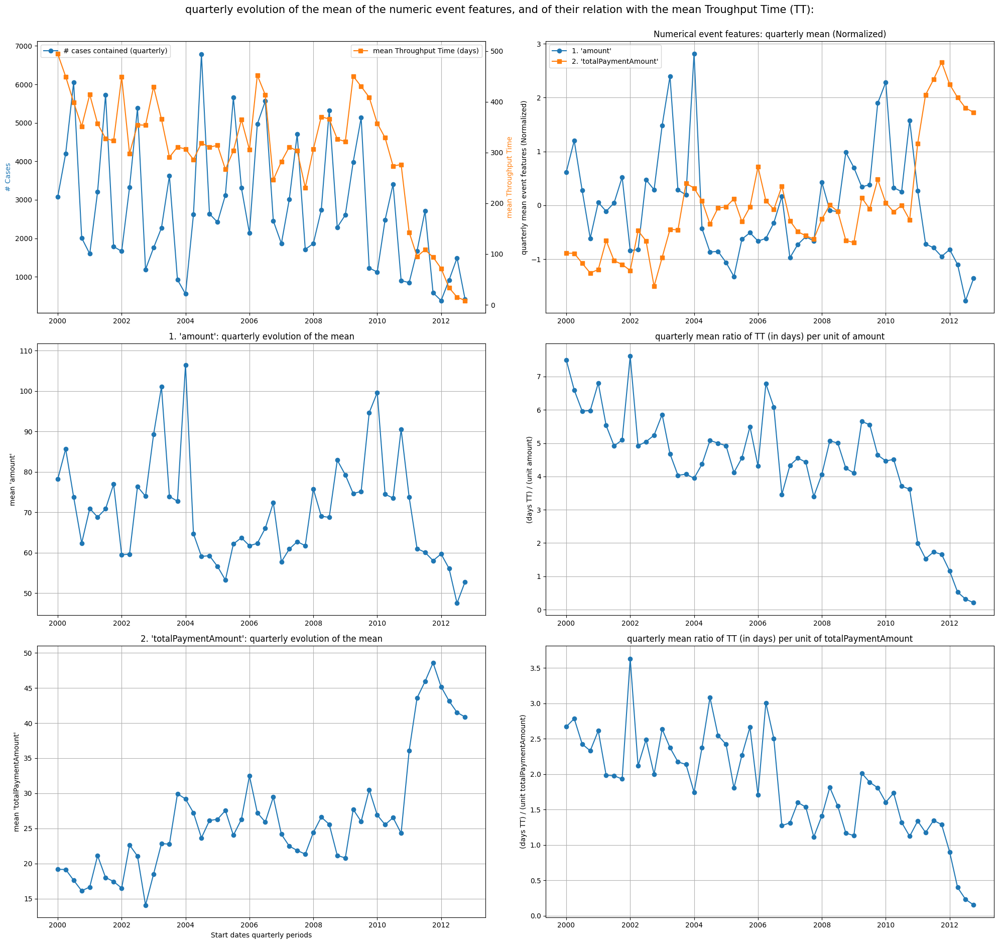

In [22]:
rtfm_plots.num_eventfts_evol(numeric_event_list = nef_subset_last, plt_type = 'type_tt', frequency= 'quarterly', numEventFt_transform = 'last')

##### Representation type: Case Length

Computing the additional quarterly NEPC aggregations for each of the 1 given numerical event features: 100%|██████████| 1/1 [00:00<00:00,  4.90it/s]


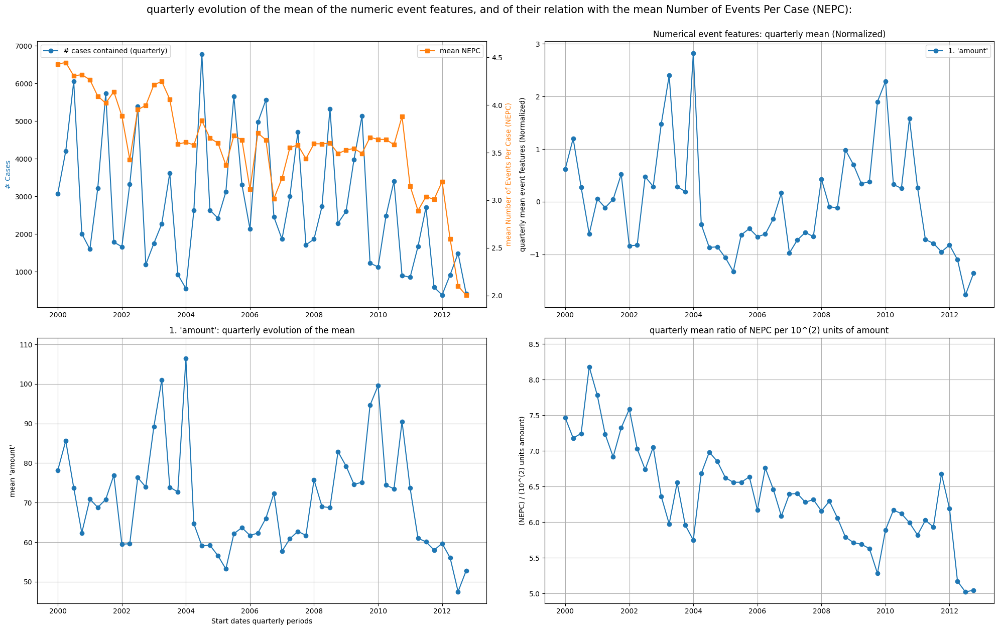

In [19]:
rtfm_plots.num_eventfts_evol(numeric_event_list = nef_subset_last, plt_type = 'type_events_case', frequency= 'quarterly', numEventFt_transform = 'last')

##### Representation type: Outcome

Computing the additional quarterly outcome aggregations for each of the 1 given numerical event features: 100%|██████████| 1/1 [00:00<00:00,  5.26it/s]


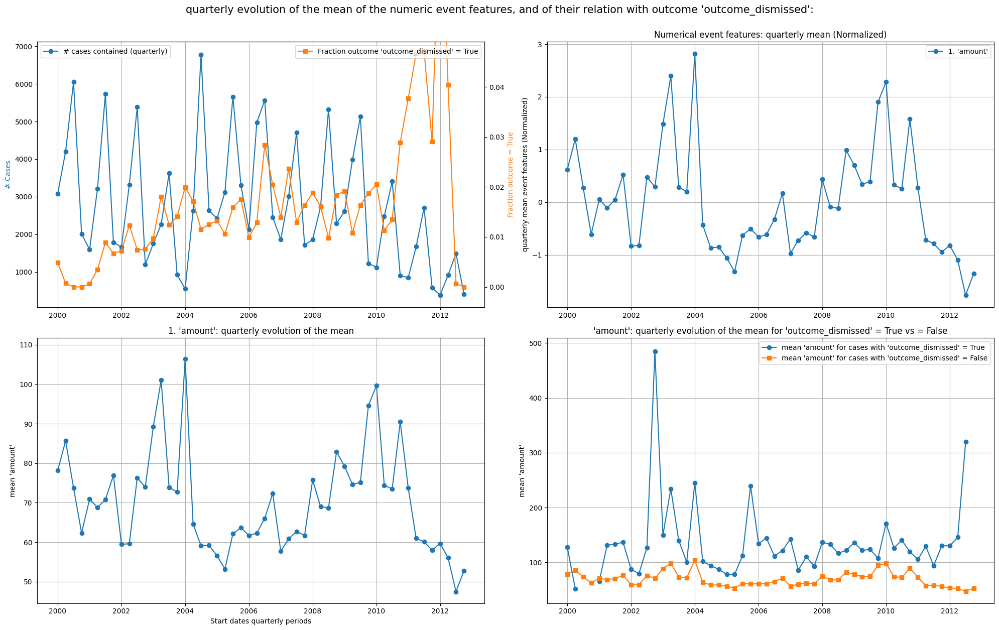

In [20]:
rtfm_plots.num_eventfts_evol(numeric_event_list = nef_subset_last, plt_type = 'type_outcome', frequency= 'quarterly', numEventFt_transform = 'last')

#### NEF: totalPaymentAmount

##### Representation type: Throughput Time

##### Representation type: Case Length

##### Representation type: Outcome

#### NEF: paymentAmount

##### Representation type: Throughput Time

C:\Users\20193673\AppData\Roaming\Python\Python311\site-packages\DyLoPro\plotting_utils.py:452: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  period_ttr = case_log_loc.pivot_table(values = num_fts_list, index = time_col, aggfunc = numeric_agg, fill_value = 0)


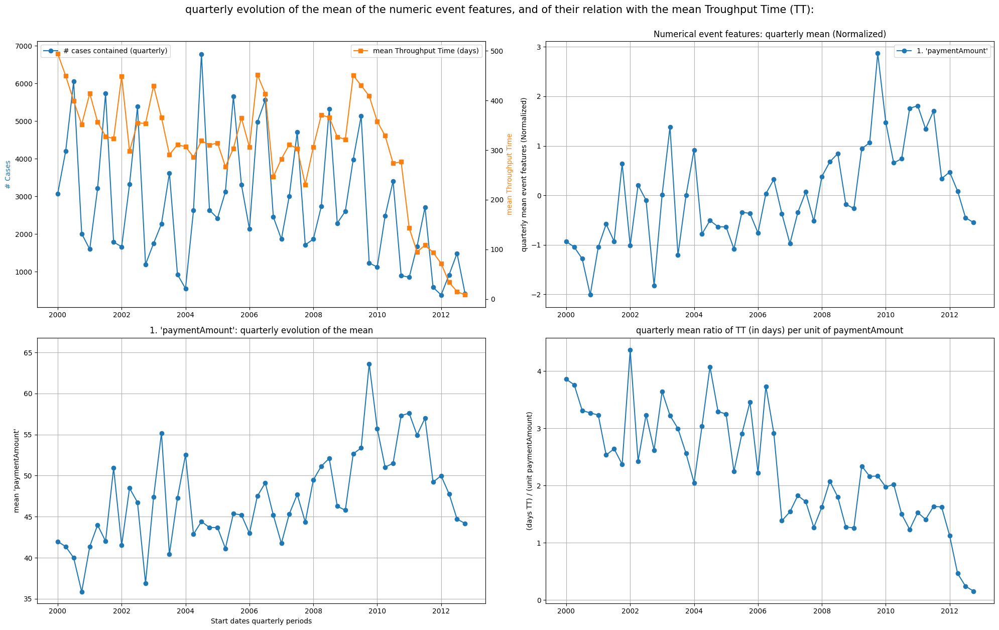

In [23]:
rtfm_plots.num_eventfts_evol(numeric_event_list = nef_subset, plt_type = 'type_tt', frequency= 'quarterly', numEventFt_transform = 'mean')

##### Representation type: Case Length

Computing the additional quarterly NEPC aggregations for each of the 1 given numerical event features: 100%|██████████| 1/1 [00:00<00:00,  4.61it/s]


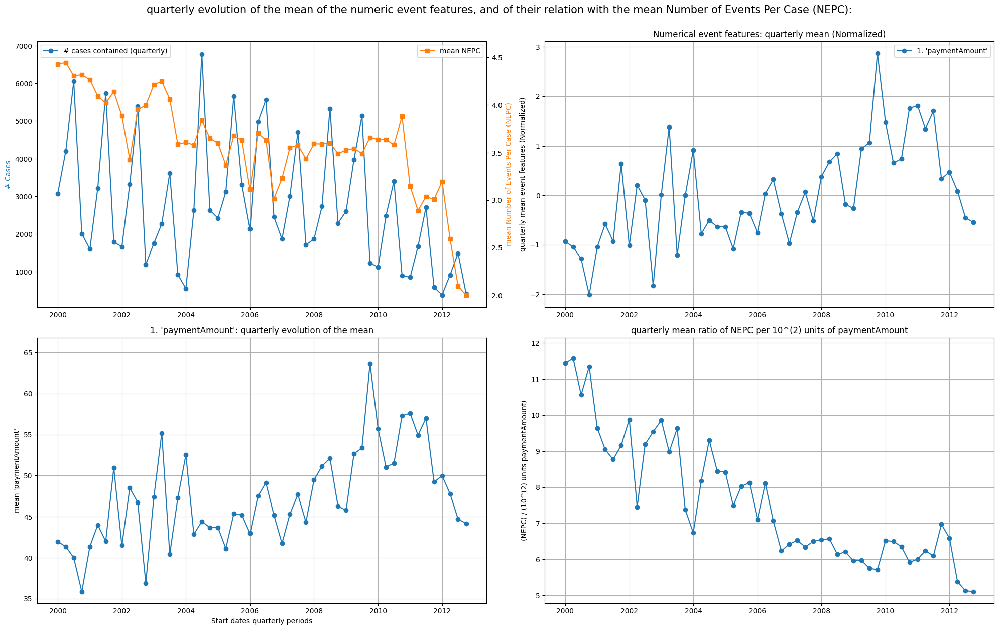

In [24]:
rtfm_plots.num_eventfts_evol(numeric_event_list = nef_subset, plt_type = 'type_events_case', frequency= 'quarterly', numEventFt_transform = 'mean')

##### Representation type: Outcome

Computing the additional quarterly outcome aggregations for each of the 1 given numerical event features: 100%|██████████| 1/1 [00:00<00:00,  6.45it/s]


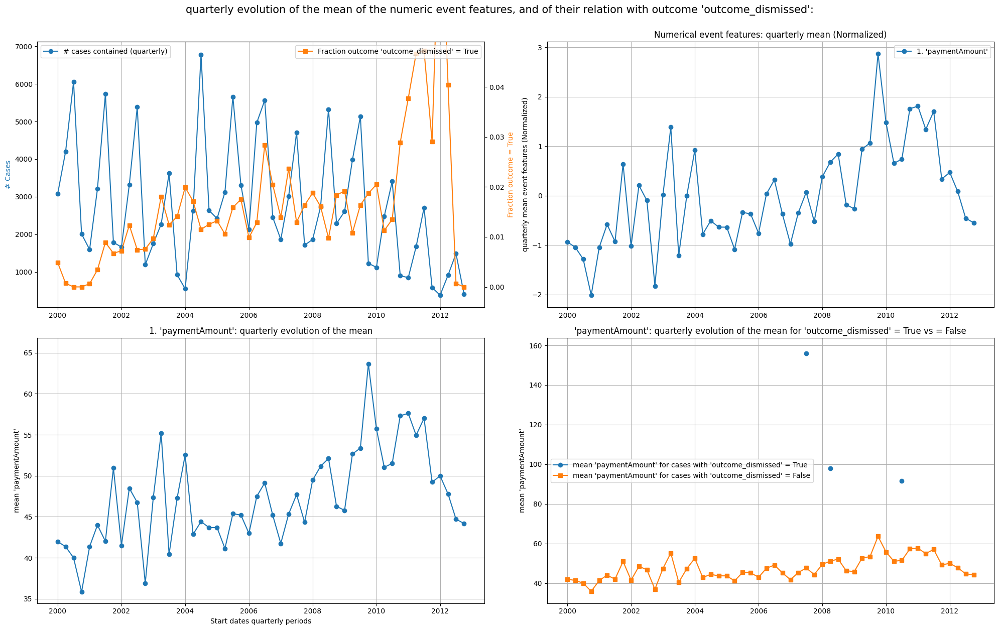

In [25]:
rtfm_plots.num_eventfts_evol(numeric_event_list = nef_subset, plt_type = 'type_outcome', frequency= 'quarterly', numEventFt_transform = 'mean')